# Generating stylistic images with stable diffusion XL

Viba Courtney-Battista

[github](https://github.com/vibabattista)

vcourtneybattista@gmail.com

30/06/2024

The aim of this notebook is to convert an image into various art styles using diffusion models. 

### Import modules

In [1]:
# Necessary imports, stable diffusion is very memory intense so the memory is displayed
import torch
import diffusers
from diffusers import StableDiffusionXLImg2ImgPipeline
from diffusers.utils import load_image, make_image_grid
from PIL import Image
print('torch version: ', torch.__version__)
print('GPU available: ', torch.cuda.is_available(), 'GPU count: ', torch.cuda.device_count(), 'Current device: ', torch.cuda.current_device(), torch.cuda.get_device_name(torch.cuda.current_device()))
device = 'cuda'
print(f"Available GPU memory: {torch.cuda.get_device_properties(0).total_memory / 1e9:.2f} GB")
print(f"Cached: {torch.cuda.memory_reserved()/1e9:.2f}GB")
print(f"Free: {torch.cuda.get_device_properties(0).total_memory/1e9 - torch.cuda.memory_allocated()/1e9 - torch.cuda.memory_reserved()/1e9:.2f}GB")

torch version:  2.3.1+cu121
GPU available:  True GPU count:  2 Current device:  0 NVIDIA GeForce RTX 4060 Ti
Available GPU memory: 8.59 GB
Cached: 0.00GB
Free: 8.59GB


### Import model

stable-diffusion-xl-refiner-1.0 is used in this notebook.
float16 precision is an excellent memory/results trade-off

Efficiency: 
-cpu offloading ensures efficient memory handling by offloading layers of the model from the GPU dynamically, preventing memory bottlenecking.
-The stable diffusion pipeline relies heavily on attention mechanisms. xformers optimises the memory usage, necessary for large images which will require a lot of RAM.

In [4]:
# Initialise pipeline
pipeline = StableDiffusionXLImg2ImgPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-refiner-1.0",
    torch_dtype=torch.float16,
    use_safetensors=True,
    variant = 'fp16'
)
#enable xformers and offloading for memory efficiency
pipeline.enable_model_cpu_offload()
pipeline.enable_xformers_memory_efficient_attention()
pipeline.enable_attention_slicing()

Loading pipeline components...: 100%|██████████| 5/5 [00:00<00:00,  6.40it/s]


### Import image

An example image from the internet of a person with their pet.
Included is an example image of a cat from huggingface datasets. (Cell output can be seen on my github page)

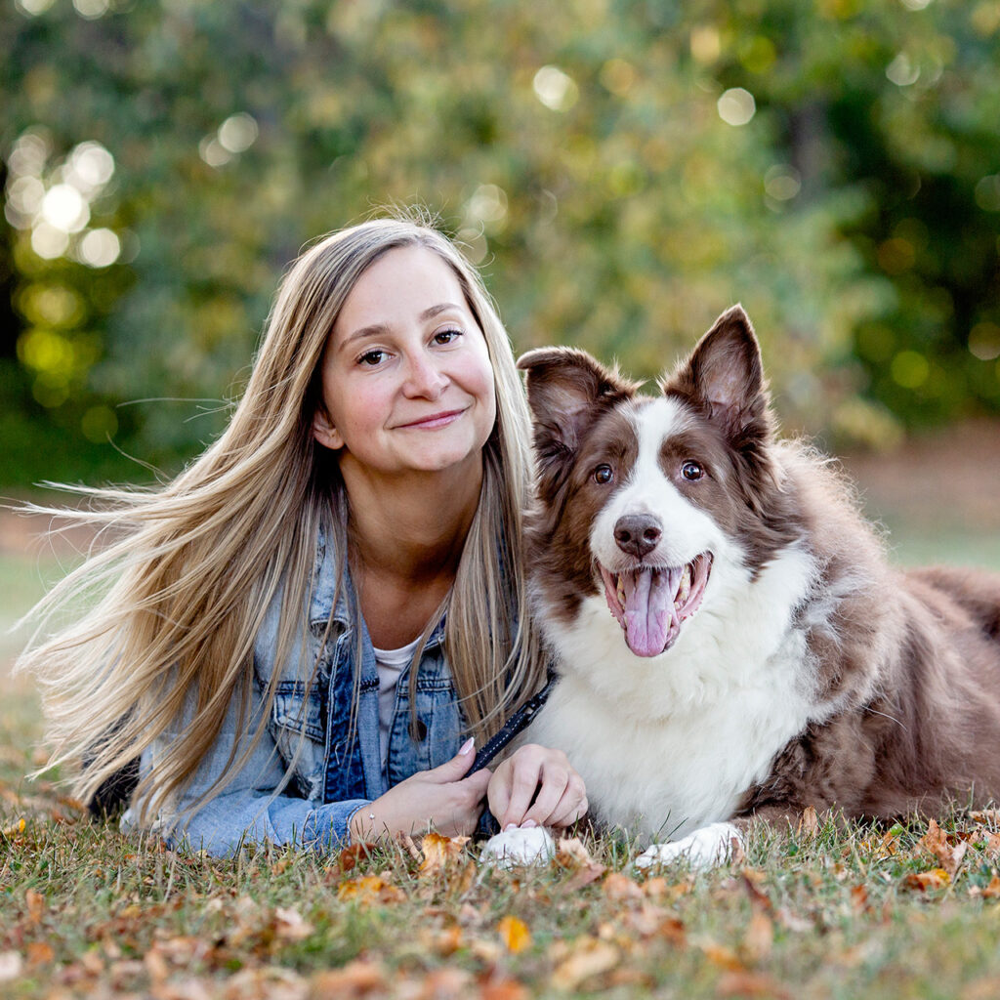

In [5]:
# Load an image from huggingface to pass to the pipeline:
# url = 'https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/cat.png'
# init_image = load_image(url).convert('RGB')
# init_image

# Load image from file and display original
file = 'lady_with_dog.jpg'
with Image.open(file) as img:
    img.load()

init_image = img
img

### Image resizing

If an image of a size other than 1024x1024 is passed through the model it may produce vastly different results.
Two options are worth considering: 
- Resize before passing through the model.
- Pass through model with height and width parameters 1024, 1024.

I choose to pass images of size 1024x1024 only into the model for consistency based on the models training.

In [84]:
def resize_and_pad(image, target_size):
    """
    Resize image to fit within target_size while maintaining aspect ratio
    """
    aspect_ratio = image.width / image.height
    if aspect_ratio > 1:
        new_width = target_size
        new_height = int(target_size / aspect_ratio)
    else:
        new_height = target_size
        new_width = int(target_size * aspect_ratio)
    
    resized_image = image.resize((new_width, new_height), Image.LANCZOS)
    
    # Create a new square image with a black background
    new_image = Image.new('RGB', (target_size, target_size), (0, 0, 0))
    
    # Paste the resized image in the center of the new square image
    paste_x = (target_size - new_width) // 2
    paste_y = (target_size - new_height) // 2
    new_image.paste(resized_image, (paste_x, paste_y))
    
    return new_image

### Pass through model

An initial pass through the pipeline with a Studio Ghibli art style prompt.

100%|██████████| 15/15 [00:21<00:00,  1.46s/it]


(1024, 1024)


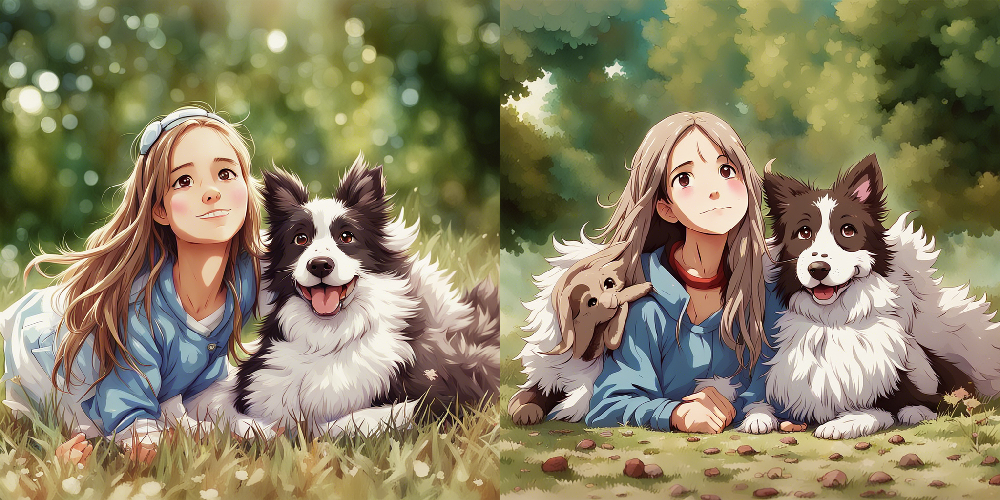

In [8]:
# Pass a prompt and image to the pipeline to generate an image:
img_size = init_image.size
# Text prompt for pipeline
prompt = 'studio ghibli, anime, adorable, happy, girl with dog' #gandalf, lord of the rings, fantasy, cute, adorable, Pixar, Disney, cartoon, anime'#, detailed, 4k'
# Show output given the parameters
images = pipeline(prompt, image=init_image, num_inference_steps=25,num_images_per_prompt=2,strength=0.6, guidance_scale=10, original_size=(512,512),target_size = (512,512)).images
print(images[0].size)
make_image_grid([*images], rows=1, cols=2)

### More anime styles

Five popular anime styles chosen from the internet: studio ghibli, pokemon, manga, disney and chibi anime.
When prompt engineering I used artist names as frequently as possible as this gives better results. Negative prompts, diffusion strength and guidance scale have also been considered.

There are three kwarg dictionaries to obtain a range of results without hyperparameter tuning.

In [18]:
# Create a dictionary of key-word arguments for generate_images
image = init_image

kwargs0 = {
    "steps": 30,
    "n": 2,
    "strength": 0.6,
    "guidance": 10,
    "size": 1024  # Square
  #  "aesthetic": 10
}

# generate images by resizing and passing through pipeline
def generate_images(prompt, image, steps, n, strength, guidance, size, show = True):
    """
    returns n images given an initial image and prompt.
    """
    images_resized = []
    images = pipeline(prompt, image=image, num_inference_steps=steps,num_images_per_prompt=n,strength=strength, guidance_scale=guidance, negative_prompt='clear background, realistic photo, photography, ugly, fused, worst face, extra face, poorly drawn, duplicate, bad eyes, bad proportions').images #original_size=(512,512),target_size = (512,512)
    for i in range(n):
      images_resized.append(resize_and_pad(images[i],size))
    if show:
        display(make_image_grid([*images_resized], rows=1, cols=n))
    return images



### Prompt engineering and tuning

To remain within the time constraints the parameters are not fine-tuned- this results in few instances of undesirable images, however can be fixed with the correct tuning. Later I leave a brief example of fine-tuning by looping through candidate parameters to be fine-tuned by eye.

The parameters were chosen with a focus on art style and likeness to the original image (For the best studio ghibli images refer to above). To do this the prompt-guidance weight is very high, and the diffusion strength is set at a minimum such that there is a noticable different in style.

Including a negative prompt of 'background' helped restrict the model for creating objects there.

100%|██████████| 25/25 [00:23<00:00,  1.07it/s]


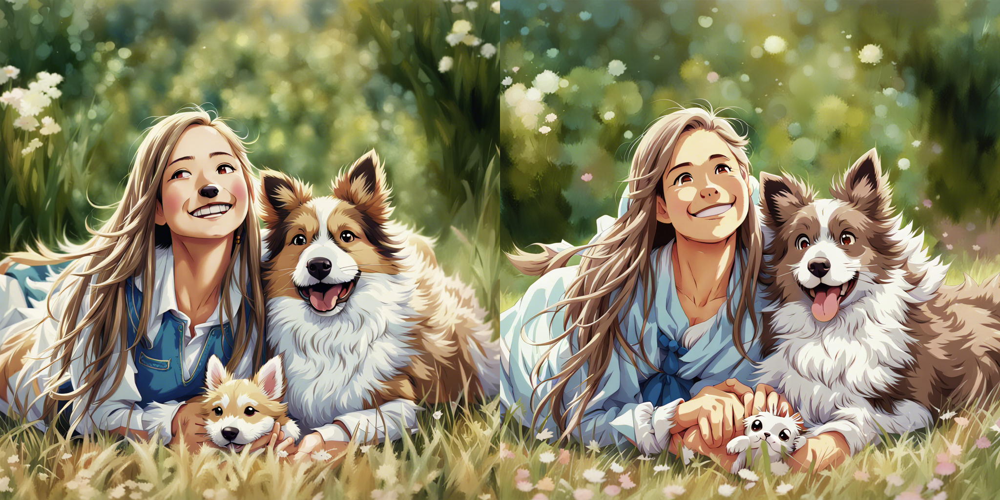

100%|██████████| 25/25 [00:23<00:00,  1.08it/s]


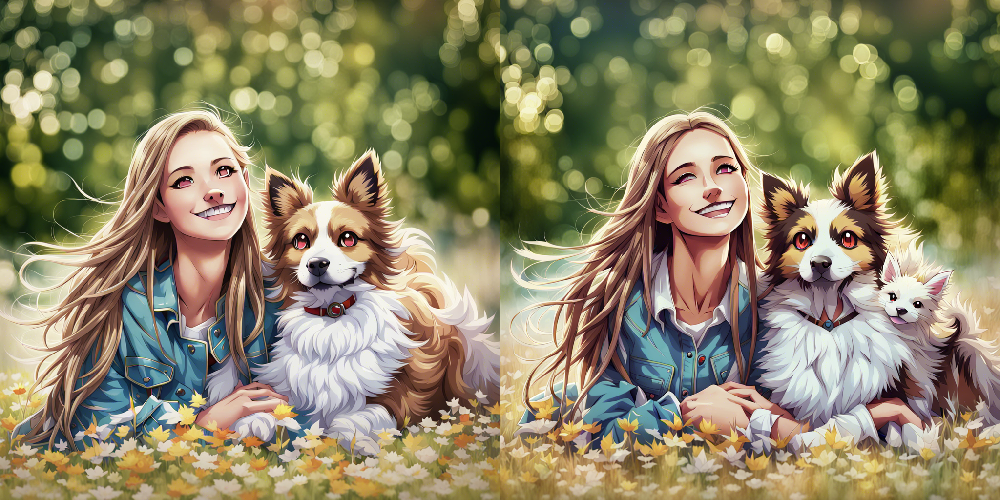

100%|██████████| 25/25 [00:23<00:00,  1.08it/s]


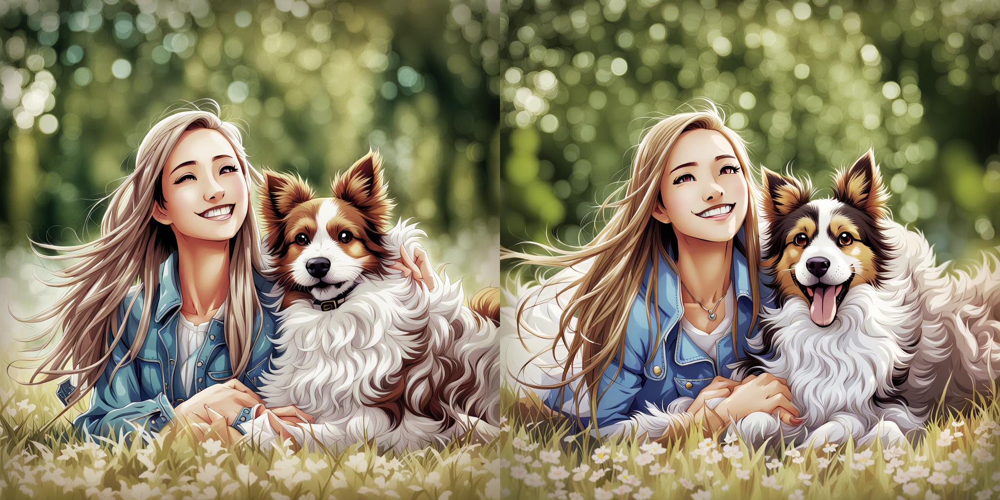

100%|██████████| 25/25 [00:23<00:00,  1.07it/s]


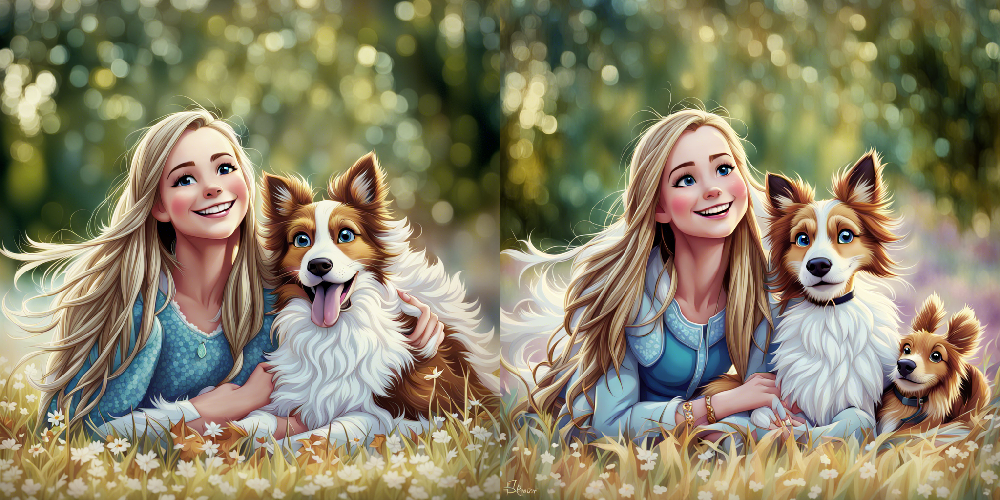

100%|██████████| 25/25 [00:23<00:00,  1.08it/s]


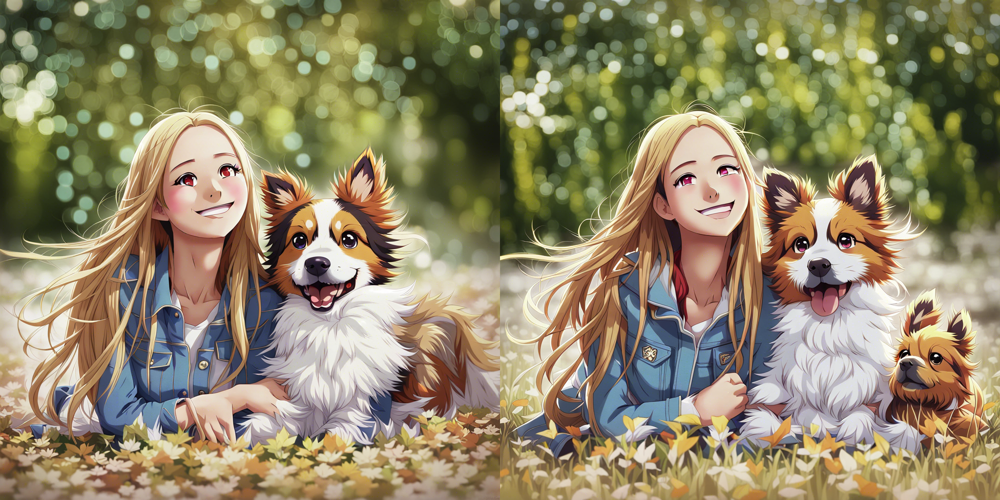

In [37]:
# Prompt engineering
prompts = ['studio ghibli, anime, adorable',
           'pokemon, pokemon style, anime, colorful',
           'manga, hand-drawn, Takeuchi Naoko style, cute',
           'cartoon, disney, modern disney, bambi style, frozen movie, princess, Keane Glen, adorable, cute',
           'anime, chibi, cute, adorable, fun, joy, Himouto! Umaru-chan, Lucky Stary'
           ]
kwargs1 = {
    "steps": 30,
    "n": 2,
    "strength": 0.5,#0.65,
    "guidance": 19,
    "size": 1024  # Square
  #  "aesthetic": 10
}
# parameter dictionary used for images below
kwargs2 = {
    "steps": 50,
    "n": 2,
    "strength": 0.5,#0.65,
    "guidance": 19,
    "size": 1024  # Square
  #  "aesthetic": 10
}
# Display two images per style
for i in range(len(prompts)):
    generate_images(prompts[i]+', animation, lady smiling with her dog', image, **kwargs2)

Example fine-tuning loop to optimise the guidance and strength and ensure generalisation across different styles.

In [ ]:
# Candidate guidance and strength values
guidance_range = [8,13,17]
strength_range = [0.4,0.45,0.5,0.55,0.6]
# 40 steps to give cleaner results
steps = 40
n = 2
size = 1024
for prompt in prompts:
    print(f"Prompt: {prompt}")
    for guidance in guidance_range:
        for strength in strength_range:
            print(f"Guidance: {guidance}, Strength: {strength}")
            generate_images(prompt, image, steps, n, strength, guidance, size)

# Next steps

To improve upon this project and allow robustness to input image shape the function should be applied on optimal image size, followed by an upscaling. The optimal image size is dependent on both memory and image quality.

Fine-tuning parameters should be done for both image quality and speed optimisation, of which following online guides will save time: [https://www.felixsanz.dev/articles/ultimate-guide-to-optimizing-stable-diffusion-xl#parameter-optimizations]. The most obvious time saver is fewer steps followed by strength and guidance optimisation, as the number of steps heavily influences the time complexity.

Introducing externel models/functions designed to remove backgrounds may be more feasible, however I decided against this as it seemed likely the model will create new objects that are considered to not be in the background.

### Noteable feature likeness/art style trade off parameters

The huggingface cat image was used with these parameters and a disney style prompt, yielding impressive results and an excellent starting point to optimise the parameters.

100%|██████████| 24/24 [00:15<00:00,  1.58it/s]


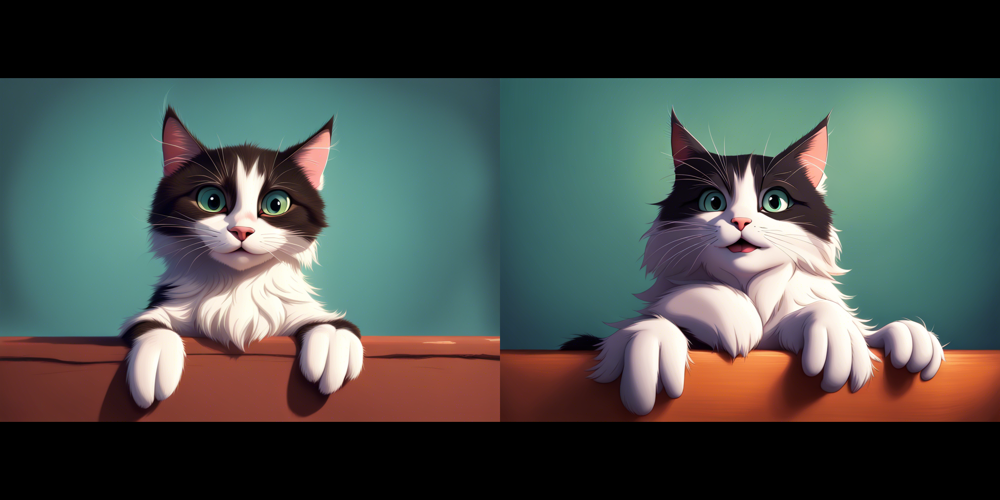

[<PIL.Image.Image image mode=RGB size=1024x1024>,
 <PIL.Image.Image image mode=RGB size=1024x1024>]

In [97]:
kwargs4 = {
    "steps": 30,
    "n": 2,
    "strength": 0.8,
    "guidance": 13,
    "size": 1024  # Square
  #  "aesthetic": 10
}
def generate_images(prompt, image, steps, n, strength, guidance, size, show = True):
    images_resized = []
    images = pipeline(prompt, image=image, num_inference_steps=steps,num_images_per_prompt=n,strength=strength, guidance_scale=guidance, original_size=(1028,704),target_size = (1028,704)).images #original_size=(512,512),target_size = (512,512)
    for i in range(n):
        images_resized.append(resize_and_pad(images[i],size))
    if show:
        display(make_image_grid([*images_resized], rows=1, cols=n))
    return images_resized
generate_images('disney, animated, animation, cat, friendly',image,**kwargs4)